In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from prophet import Prophet
from prophet.plot import plot_components_plotly, plot_plotly

from sklearn.metrics import mean_squared_error,root_mean_squared_error,r2_score

import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv(r"C:\Users\Admin\OneDrive\Desktop\DS\datasets\time series forecasting datasets\weather_data.csv")

In [3]:
df

,Year,Day,Wind Speed,Specific Humidity,Relative Humidity,Precipitation,Temperature
0,1990,1,1.08,5.68,53.06,0.0,16.33
1,1990,2,1.13,5.92,58.06,0.0,15.68
2,1990,3,1.33,5.68,52.69,0.0,16.56
3,1990,4,1.09,5.19,47.19,0.0,17.09
4,1990,5,0.94,4.82,42.88,0.0,17.26
...,...,...,...,...,...,...,...
12108,2023,56,1.28,8.85,50.44,0.0,24.52
12109,2023,57,1.41,6.59,38.06,0.0,24.62
12110,2023,58,1.60,6.04,34.56,0.0,24.28
12111,2023,59,1.49,6.65,38.94,0.0,23.97


In [4]:
df = df[["Year","Day","Temperature"]]
df

,Year,Day,Temperature
0,1990,1,16.33
1,1990,2,15.68
2,1990,3,16.56
3,1990,4,17.09
4,1990,5,17.26
...,...,...,...
12108,2023,56,24.52
12109,2023,57,24.62
12110,2023,58,24.28
12111,2023,59,23.97


In [5]:
df.isna().sum()

Year           0
Day            0
Temperature    0
dtype: int64

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12113 entries, 0 to 12112
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Year         12113 non-null  int64  
 1   Day          12113 non-null  int64  
 2   Temperature  12113 non-null  float64
dtypes: float64(1), int64(2)
memory usage: 284.0 KB


In [7]:
df["date"] = pd.to_datetime(df["Year"].astype(str) + df["Day"].astype(str), format="%Y%j")
df.head()

,Year,Day,Temperature,date
0,1990,1,16.33,1990-01-01
1,1990,2,15.68,1990-01-02
2,1990,3,16.56,1990-01-03
3,1990,4,17.09,1990-01-04
4,1990,5,17.26,1990-01-05


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12113 entries, 0 to 12112
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Year         12113 non-null  int64         
 1   Day          12113 non-null  int64         
 2   Temperature  12113 non-null  float64       
 3   date         12113 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(1), int64(2)
memory usage: 378.7 KB


In [9]:
df = df[["date","Temperature"]]
df

,date,Temperature
0,1990-01-01,16.33
1,1990-01-02,15.68
2,1990-01-03,16.56
3,1990-01-04,17.09
4,1990-01-05,17.26
...,...,...
12108,2023-02-25,24.52
12109,2023-02-26,24.62
12110,2023-02-27,24.28
12111,2023-02-28,23.97


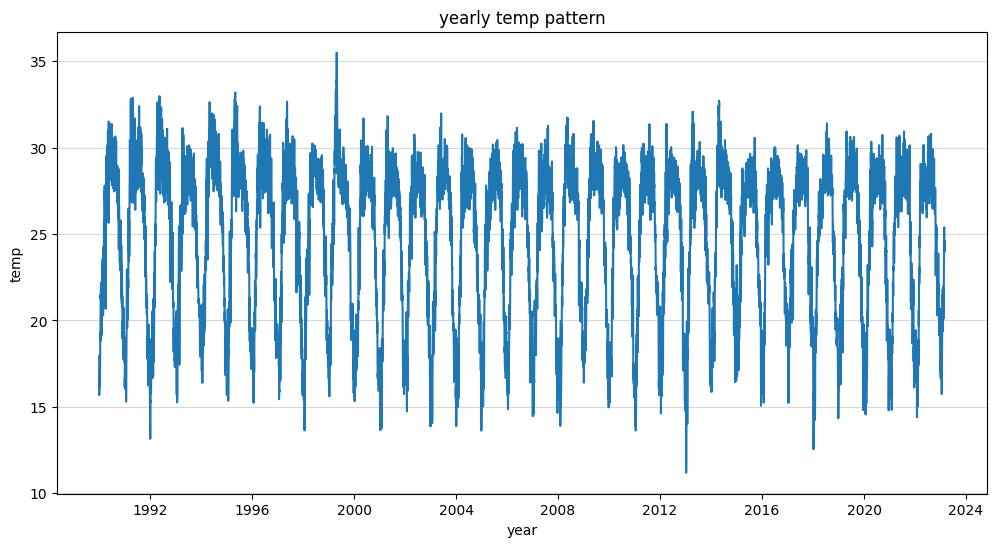

In [10]:
plt.figure(figsize=(12,6))
plt.plot(df["date"],df["Temperature"])
plt.title("yearly temp pattern")
plt.xlabel("year")
plt.ylabel("temp")
plt.grid(axis="y",alpha=0.5)
plt.show()

In [11]:
df.columns = ["ds","y"]
df

,ds,y
0,1990-01-01,16.33
1,1990-01-02,15.68
2,1990-01-03,16.56
3,1990-01-04,17.09
4,1990-01-05,17.26
...,...,...
12108,2023-02-25,24.52
12109,2023-02-26,24.62
12110,2023-02-27,24.28
12111,2023-02-28,23.97


In [12]:
train = df[:len(df)-365]
test = df[len(df)-365:]

In [13]:
print(train.shape)
print(test.shape)

(11748, 2)
(365, 2)


In [14]:
model = Prophet()

In [15]:
model.fit(train)

10:51:23 - cmdstanpy - INFO - Chain [1] start processing
10:51:28 - cmdstanpy - INFO - Chain [1] done processing


In [16]:
dates = model.make_future_dataframe(periods=365)

In [17]:
forecasting = model.predict(dates)
forecasting

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,1990-01-01,25.646742,16.185002,19.662693,25.646742,25.646742,-7.717665,-7.717665,-7.717665,-0.010218,-0.010218,-0.010218,-7.707447,-7.707447,-7.707447,0.0,0.0,0.0,17.929077
1,1990-01-02,25.646202,16.108410,19.505920,25.646202,25.646202,-7.760217,-7.760217,-7.760217,-0.016700,-0.016700,-0.016700,-7.743517,-7.743517,-7.743517,0.0,0.0,0.0,17.885985
2,1990-01-03,25.645661,16.082728,19.658970,25.645661,25.645661,-7.778865,-7.778865,-7.778865,-0.000927,-0.000927,-0.000927,-7.777938,-7.777938,-7.777938,0.0,0.0,0.0,17.866796
3,1990-01-04,25.645120,16.216812,19.666380,25.645120,25.645120,-7.786992,-7.786992,-7.786992,0.023555,0.023555,0.023555,-7.810547,-7.810547,-7.810547,0.0,0.0,0.0,17.858129
4,1990-01-05,25.644580,16.080427,19.573191,25.644580,25.644580,-7.848912,-7.848912,-7.848912,-0.007796,-0.007796,-0.007796,-7.841116,-7.841116,-7.841116,0.0,0.0,0.0,17.795668
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12108,2023-02-25,24.644731,20.186821,23.554377,24.557724,24.722086,-2.779347,-2.779347,-2.779347,-0.007718,-0.007718,-0.007718,-2.771629,-2.771629,-2.771629,0.0,0.0,0.0,21.865383
12109,2023-02-26,24.644543,20.344807,23.686676,24.557295,24.722274,-2.585625,-2.585625,-2.585625,0.019804,0.019804,0.019804,-2.605429,-2.605429,-2.605429,0.0,0.0,0.0,22.058918
12110,2023-02-27,24.644356,20.293464,23.765073,24.556865,24.722461,-2.448376,-2.448376,-2.448376,-0.010218,-0.010218,-0.010218,-2.438158,-2.438158,-2.438158,0.0,0.0,0.0,22.195980
12111,2023-02-28,24.644169,20.731619,24.208624,24.556436,24.722639,-2.286461,-2.286461,-2.286461,-0.016700,-0.016700,-0.016700,-2.269761,-2.269761,-2.269761,0.0,0.0,0.0,22.357709


In [18]:
forecasting = forecasting[["ds","yhat","yhat_lower","yhat_upper","trend","trend_upper","trend_lower"]]
forecasting 

,ds,yhat,yhat_lower,yhat_upper,trend,trend_upper,trend_lower
0,1990-01-01,17.929077,16.185002,19.662693,25.646742,25.646742,25.646742
1,1990-01-02,17.885985,16.108410,19.505920,25.646202,25.646202,25.646202
2,1990-01-03,17.866796,16.082728,19.658970,25.645661,25.645661,25.645661
3,1990-01-04,17.858129,16.216812,19.666380,25.645120,25.645120,25.645120
4,1990-01-05,17.795668,16.080427,19.573191,25.644580,25.644580,25.644580
...,...,...,...,...,...,...,...
12108,2023-02-25,21.865383,20.186821,23.554377,24.644731,24.722086,24.557724
12109,2023-02-26,22.058918,20.344807,23.686676,24.644543,24.722274,24.557295
12110,2023-02-27,22.195980,20.293464,23.765073,24.644356,24.722461,24.556865
12111,2023-02-28,22.357709,20.731619,24.208624,24.644169,24.722639,24.556436


In [19]:
plot_plotly(model,forecasting,figsize=(900, 600))

In [20]:
plot_components_plotly(model,forecasting)

In [47]:
test["pred"] = forecasting.iloc[-365:]["yhat"]


In [48]:
test

,ds,y,pred
11748,2022-03-02,22.11,22.824437
11749,2022-03-03,22.33,23.020705
11750,2022-03-04,23.05,23.162058
11751,2022-03-05,22.80,23.335600
11752,2022-03-06,22.90,23.537141
...,...,...,...
12108,2023-02-25,24.52,21.865383
12109,2023-02-26,24.62,22.058918
12110,2023-02-27,24.28,22.195980
12111,2023-02-28,23.97,22.357709


In [49]:
root_mean_squared_error(test["y"],test["pred"])

1.4411866461464413

In [50]:
test["y"].mean()

np.float64(25.39978082191781)

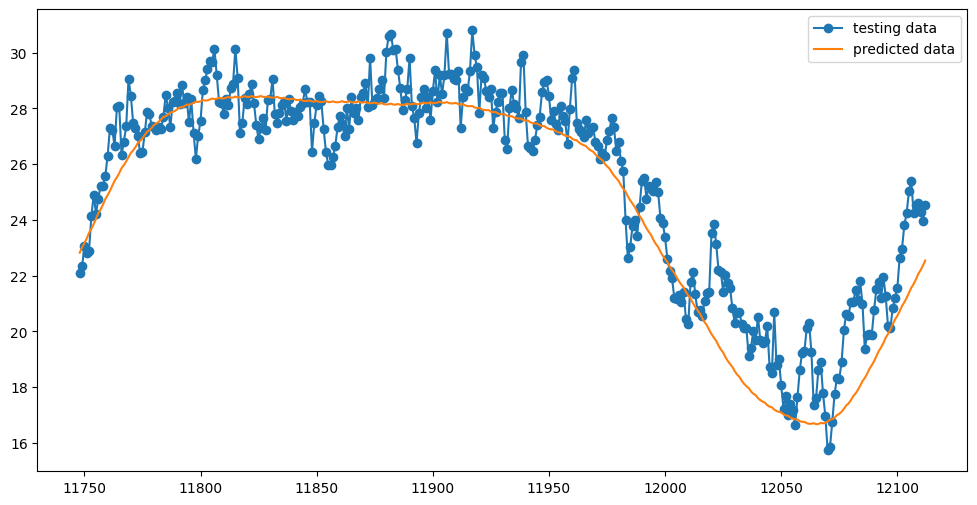

In [54]:
plt.figure(figsize=(12,6))
plt.plot(test["y"],label="testing data",marker="o")
plt.plot(test["pred"],label="predicted data")
plt.legend()
plt.show()

In [55]:
# model for predicting the data for next 365 days

In [56]:
model1 = Prophet()

In [63]:
model1.fit(df)

11:26:36 - cmdstanpy - INFO - Chain [1] start processing
11:26:42 - cmdstanpy - INFO - Chain [1] done processing


In [65]:
dates1 = model1.make_future_dataframe(periods=365)
forecasting1 = model1.predict(dates1)
forecasting1

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,1990-01-01,25.614766,16.265201,19.597870,25.614766,25.614766,-7.707028,-7.707028,-7.707028,-0.009687,-0.009687,-0.009687,-7.697341,-7.697341,-7.697341,0.0,0.0,0.0,17.907737
1,1990-01-02,25.614334,16.173183,19.656637,25.614334,25.614334,-7.747612,-7.747612,-7.747612,-0.013991,-0.013991,-0.013991,-7.733620,-7.733620,-7.733620,0.0,0.0,0.0,17.866723
2,1990-01-03,25.613903,16.005780,19.419812,25.613903,25.613903,-7.769226,-7.769226,-7.769226,-0.001237,-0.001237,-0.001237,-7.767989,-7.767989,-7.767989,0.0,0.0,0.0,17.844677
3,1990-01-04,25.613472,16.147223,19.471919,25.613472,25.613472,-7.777948,-7.777948,-7.777948,0.022362,0.022362,0.022362,-7.800309,-7.800309,-7.800309,0.0,0.0,0.0,17.835524
4,1990-01-05,25.613041,15.946415,19.655318,25.613041,25.613041,-7.839837,-7.839837,-7.839837,-0.009454,-0.009454,-0.009454,-7.830382,-7.830382,-7.830382,0.0,0.0,0.0,17.773204
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12473,2024-02-25,25.029133,20.442842,23.932409,24.964862,25.107541,-2.777502,-2.777502,-2.777502,0.019145,0.019145,0.019145,-2.796648,-2.796648,-2.796648,0.0,0.0,0.0,22.251631
12474,2024-02-26,25.029157,20.678828,24.091032,24.964493,25.108448,-2.642070,-2.642070,-2.642070,-0.009687,-0.009687,-0.009687,-2.632383,-2.632383,-2.632383,0.0,0.0,0.0,22.387087
12475,2024-02-27,25.029181,20.912875,24.369408,24.964123,25.109242,-2.480886,-2.480886,-2.480886,-0.013991,-0.013991,-0.013991,-2.466894,-2.466894,-2.466894,0.0,0.0,0.0,22.548295
12476,2024-02-28,25.029205,20.947842,24.370112,24.963754,25.109958,-2.301324,-2.301324,-2.301324,-0.001237,-0.001237,-0.001237,-2.300087,-2.300087,-2.300087,0.0,0.0,0.0,22.727881


In [66]:
forecasting1 = forecasting1[["ds","yhat","yhat_lower","yhat_upper","trend","trend_upper","trend_lower"]]
forecasting1 

,ds,yhat,yhat_lower,yhat_upper,trend,trend_upper,trend_lower
0,1990-01-01,17.907737,16.265201,19.597870,25.614766,25.614766,25.614766
1,1990-01-02,17.866723,16.173183,19.656637,25.614334,25.614334,25.614334
2,1990-01-03,17.844677,16.005780,19.419812,25.613903,25.613903,25.613903
3,1990-01-04,17.835524,16.147223,19.471919,25.613472,25.613472,25.613472
4,1990-01-05,17.773204,15.946415,19.655318,25.613041,25.613041,25.613041
...,...,...,...,...,...,...,...
12473,2024-02-25,22.251631,20.442842,23.932409,25.029133,25.107541,24.964862
12474,2024-02-26,22.387087,20.678828,24.091032,25.029157,25.108448,24.964493
12475,2024-02-27,22.548295,20.912875,24.369408,25.029181,25.109242,24.964123
12476,2024-02-28,22.727881,20.947842,24.370112,25.029205,25.109958,24.963754


In [67]:
plot_plotly(model1,forecasting1,figsize=(900, 600))

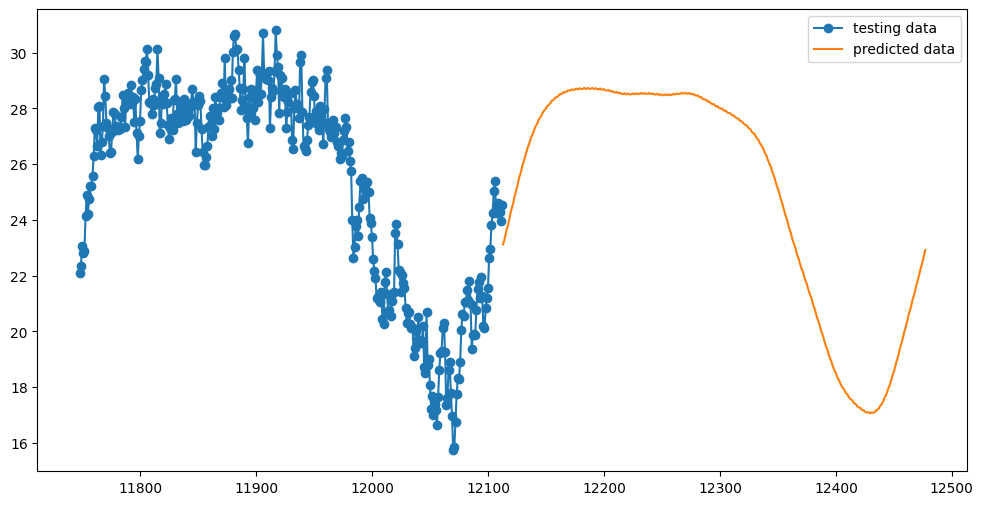

In [77]:
plt.figure(figsize=(12,6))
plt.plot(test["y"],label="testing data",marker="o")
plt.plot(forecasting1.iloc[-365:]["yhat"],label="predicted data")
plt.legend()
plt.show()

In [76]:
forecasting1.iloc[-365:]["yhat"]

12113    23.123106
12114    23.262540
12115    23.437329
12116    23.637150
12117    23.782723
           ...    
12473    22.251631
12474    22.387087
12475    22.548295
12476    22.727881
12477    22.919684
Name: yhat, Length: 365, dtype: float64

In [75]:
test["y"]

11748    22.11
11749    22.33
11750    23.05
11751    22.80
11752    22.90
         ...  
12108    24.52
12109    24.62
12110    24.28
12111    23.97
12112    24.52
Name: y, Length: 365, dtype: float64